<a href="https://colab.research.google.com/github/Swapnil-Datta/SIGNATURE-VERIFICATION-MODEL/blob/main/SignatureVerificationSwapnil.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Signature Verification and Frawd Detection Model**

# **Resource used**

[Feature Extraction for Signature Verification
Using Hilditch Algorithm
](https://www.ijert.org/research/feature-extraction-for-signature-verification-using-hilditch-algorithm-IJERTV3IS051330.pdf)

##To Get The Database From The Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import shutil

# Step 3: Define source and destination paths
source_path = '/content/drive/MyDrive/SignatureRecognation/archive.zip'
destination_path = '/content/archive.zip'

#Move the folder
#shutil.move(destination_path, source_path)
#Copy the folder
shutil.copy(source_path, destination_path)

print(f'Folder copy from {source_path} to {destination_path}')

Folder copy from /content/drive/MyDrive/SignatureRecognation/archive.zip to /content/archive.zip


In [ ]:
# prompt: extract a file

import zipfile
with zipfile.ZipFile('/content/archive.zip', 'r') as zip_ref:
  zip_ref.extractall('/content')
print(f'Folder Extracted')

Folder Extracted


In [ ]:
import os
import shutil

def delete_non_empty_folder(folder_path):
  for filename in os.listdir(folder_path):
    file_path = os.path.join(folder_path, filename)
    if os.path.isfile(file_path):
      os.remove(file_path)
    elif os.path.isdir(file_path):
      delete_non_empty_folder(file_path)
  os.rmdir(folder_path)

# Example usage
delete_non_empty_folder("/content/sign_data/sign_data")

## 1. Main Code

Importing Dependencies

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
import shutil
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from skimage.morphology import skeletonize
from skimage.morphology import thin
from skimage.color import rgb2gray
from skimage import img_as_ubyte
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2

Making new directories

In [ ]:
!mkdir Train
!mkdir Test

!mkdir Train/Fake
!mkdir Train/Real

!mkdir Test/Fake
!mkdir Test/Real

Splitting Datas

In [ ]:
PATH = "/content/sign_data/train/"
for i in os.listdir(PATH):
    contol = i.split("_")
    if len(contol) > 1 and contol[1]=="forg":
        print(contol)
        os.system("cp -r {} Train/Fake".format(PATH+i))
    else:
        os.system("cp -r {} Train/Real".format(PATH+i))

['061', 'forg']
['064', 'forg']
['037', 'forg']
['023', 'forg']
['014', 'forg']
['024', 'forg']
['004', 'forg']
['029', 'forg']
['017', 'forg']
['055', 'forg']
['067', 'forg']
['060', 'forg']
['028', 'forg']
['016', 'forg']
['015', 'forg']
['002', 'forg']
['027', 'forg']
['001', 'forg']
['062', 'forg']
['020', 'forg']
['038', 'forg']
['051', 'forg']
['030', 'forg']
['019', 'forg']
['056', 'forg']
['032', 'forg']
['035', 'forg']
['049', 'forg']
['040', 'forg']
['036', 'forg']
['009', 'forg']
['022', 'forg']
['031', 'forg']
['058', 'forg']
['069', 'forg']
['063', 'forg']
['047', 'forg']
['013', 'forg']
['012', 'forg']
['043', 'forg']
['057', 'forg']
['026', 'forg']
['068', 'forg']
['050', 'forg']
['025', 'forg']
['045', 'forg']
['006', 'forg']
['042', 'forg']
['048', 'forg']
['018', 'forg']
['053', 'forg']
['059', 'forg']
['046', 'forg']
['041', 'forg']
['054', 'forg']
['021', 'forg']
['033', 'forg']
['003', 'forg']
['065', 'forg']
['052', 'forg']
['044', 'forg']
['034', 'forg']
['039', 

In [ ]:
PATH = "/content/sign_data/test/"
for i in os.listdir(PATH):
    contol = i.split("_")
    if len(contol) > 1 and contol[1]=="forg": # Check if list has at least two elements
        print(contol)
        os.system("cp -r {} Test/Fake".format(PATH+i))
    else:
        os.system("cp -r {} Test/Real".format(PATH+i))

['061', 'forg']
['064', 'forg']
['055', 'forg']
['067', 'forg']
['060', 'forg']
['062', 'forg']
['051', 'forg']
['056', 'forg']
['049', 'forg']
['058', 'forg']
['069', 'forg']
['063', 'forg']
['057', 'forg']
['068', 'forg']
['050', 'forg']
['053', 'forg']
['059', 'forg']
['054', 'forg']
['065', 'forg']
['052', 'forg']
['066', 'forg']


Getting Path to The Test and Train Folder

In [ ]:
train_dir = os.path.join("/content/Train")

test_dir = os.path.join("/content/Test")

##Processing And Feature Extraction from the images

In [ ]:
import cv2
import numpy as np
from skimage.morphology import skeletonize as sk_skeletonize
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

def remove_noise(image):
    # Convert the image from [0, 1] to [0, 255] and to uint8
    image_uint8 = (image * 255).astype(np.uint8)

    # Convert to grayscale if the image is RGB
    if len(image_uint8.shape) == 3 and image_uint8.shape[2] == 3:
        gray_image = cv2.cvtColor(image_uint8, cv2.COLOR_RGB2GRAY)
    else:
        gray_image = image_uint8

    # Apply adaptive thresholding
    binary_image = cv2.adaptiveThreshold(
        gray_image,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11,  # Block size
        2    # Constant subtracted from the mean
    )

    # Debug: Display the binary image
    plt.figure()
    plt.title("Binary Image after Noise Removal")
    plt.imshow(binary_image, cmap='gray')
    plt.show()

    # Logical index of pixels to keep
    logInd = gray_image > 0

    # Initialize R, G, B channels with specific values
    R = np.full(image.shape, 5, dtype=np.uint8)
    G = np.full(image.shape, 3, dtype=np.uint8)
    B = np.full(image.shape, 20, dtype=np.uint8)

    # Get original pixels without noise
    R[logInd] = image_uint8[logInd]
    G[logInd] = image_uint8[logInd]
    B[logInd] = image_uint8[logInd]

    # Concatenate Red, Green, Blue channels
    rgbImage = np.stack((R, G, B), axis=-1)

    # Convert back to grayscale for visualization
    denoised_image = rgb2gray(rgbImage)

    return denoised_image


def skeletonize(image):
    # Ensure image is a numpy array
    if not isinstance(image, np.ndarray):
        raise ValueError("Input image must be a numpy array.")

    # Convert to grayscale if it's not already
    if len(image.shape) == 3 and image.shape[2] == 3:  # RGB image
        gray_image = cv2.cvtColor(image.astype(np.uint8), cv2.COLOR_RGB2GRAY)
    elif len(image.shape) == 2:  # Grayscale image
        gray_image = image
    else:
        raise ValueError("Input image must be either RGB or grayscale.")

    # Ensure the image is in 8-bit format
    gray_image = gray_image.astype(np.uint8)

    # Apply adaptive thresholding
    binary_image = cv2.adaptiveThreshold(
        gray_image,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        11,  # Block size
        2    # Constant subtracted from the mean
    )

    # Debug: Display the binary image for skeletonization
    plt.figure()
    plt.title("Binary Image for Skeletonization")
    plt.imshow(binary_image, cmap='gray')
    plt.show()

    # Skeletonize the binary image
    skeletonized_image = sk_skeletonize(binary_image / 255.0).astype(np.uint8) * 255

    # Invert the image
    thinned_image = 255 - skeletonized_image

    return thinned_image.astype(np.float32) / 255.0  # Convert to float and rescale to [0, 1]


def hivr(skeletonized_image):
    # Check if the image is loaded correctly
    if skeletonized_image is None:
        print("Failed to load skeletonized image.")
        return None

    # Convert the image to 8-bit grayscale if it's not already
    if skeletonized_image.dtype != np.uint8:
        skeletonized_image = (skeletonized_image * 255).astype(np.uint8)  # Convert to 8-bit

    # Detect edges using Canny edge detection on the skeletonized image
    edges = cv2.Canny(skeletonized_image, 50, 150)

    # Debug: Display the edges image
    plt.figure()
    plt.title("Edges Detected by Canny")
    plt.imshow(edges, cmap='gray')
    plt.show()

    # Extract features from the edges (high variation regions)
    features = []

    # Iterate over each high variation region
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    for contour in contours:
        # Extract features from each region (example: perimeter)
        perimeter = cv2.arcLength(contour, True)
        features.append(perimeter)

    return edges.astype(np.float32) / 255.0


def detect_cross_over_loops(edges):
    # Ensure edges are in 8-bit format
    if edges.dtype != np.uint8:
        edges = (edges * 255).astype(np.uint8)

    # Apply morphological dilation to thicken lines
    dilated_image = cv2.dilate(edges, np.ones((3, 3), dtype=np.uint8), iterations=1)
    # Apply morphological erosion to thin the lines slightly
    eroded_image = cv2.erode(edges, np.ones((3, 3), dtype=np.uint8), iterations=1)

    # Perform bitwise AND operation between the dilated and eroded images to find intersections
    cross_over_loops = cv2.bitwise_and(dilated_image, eroded_image)

    # Further dilation to enhance features
    dilated_cross_over_loops = cv2.dilate(cross_over_loops, np.ones((5, 5), dtype=np.uint8), iterations=1)

    # Debug: Display the cross-over loops
    plt.figure()
    plt.title("Cross Over Loops")
    plt.imshow(dilated_cross_over_loops, cmap='gray')
    plt.show()

    return dilated_cross_over_loops


def custom_preprocessing(image):
    # Apply your preprocessing steps
    denoised_image = remove_noise(image)
    denoised_image = 1 - denoised_image  # Invert the black and white

    # Debug: Display the denoised image
    plt.figure()
    plt.title("Denoised Image")
    plt.imshow(denoised_image, cmap='gray')
    plt.show()

    # Skeletonize the denoised image
    skeletonized_image = skeletonize(denoised_image)

    # Convert the single-channel skeletonized image to a 3-channel image
    skeletonized_image_rgb = np.stack((skeletonized_image,)*3, axis=-1)

    # Debug: Display the skeletonized image
    plt.figure()
    plt.title("Skeletonized Image")
    plt.imshow(skeletonized_image_rgb, cmap='gray')
    plt.show()

    # Apply High Intensity Variation Regions
    hivr_image = hivr(skeletonized_image)
    hivr_image = 1 - hivr_image

    # Convert the single-channel grayscale image to a 3-channel image
    hivr_image_rgb = np.stack((hivr_image,)*3, axis=-1)

    # Debug: Display the high intensity variation regions
    plt.figure()
    plt.title("High Intensity Variation Regions")
    plt.imshow(hivr_image_rgb, cmap='gray')
    plt.show()

    # Detect cross-over loops
    cross_over_loops = detect_cross_over_loops(hivr_image)
    cross_over_loops = 1 - cross_over_loops

    # Ensure cross_over_loops is in 8-bit format
    cross_over_loops = (cross_over_loops * 255).astype(np.uint8)

    # Convert the image to grayscale for further processing
    cross_over_loops_gray = cv2.cvtColor(cross_over_loops, cv2.COLOR_GRAY2BGR) # Convert grayscale to 3-channel BGR

    # Reapply skeletonization on grayscale cross-over loops
    cross_over_loops_skeletonized = skeletonize(cross_over_loops_gray)

    # Convert the skeletonized cross-over loops back to a 3-channel image
    cross_over_loops_rgb = np.stack((cross_over_loops_skeletonized,)*3, axis=-1)
    cross_over_loops_rgb = 1 - cross_over_loops_rgb

    # Debug: Display the cross-over loops
    plt.figure()
    plt.title("Cross Over Loops")
    plt.imshow(cross_over_loops_rgb, cmap='gray')
    plt.show()

    return cross_over_loops_rgb  # Return the 3-channel cross-over loops image






train_datagen = ImageDataGenerator(
    preprocessing_function=custom_preprocessing,
    fill_mode='nearest')

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(200, 200),
    batch_size=64,
    class_mode='binary')

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(200, 200),
    batch_size=64,
    class_mode='binary')


Found 1649 images belonging to 2 classes.
Found 500 images belonging to 2 classes.


##Visualization

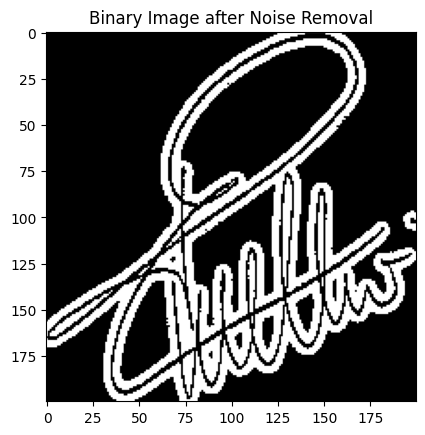

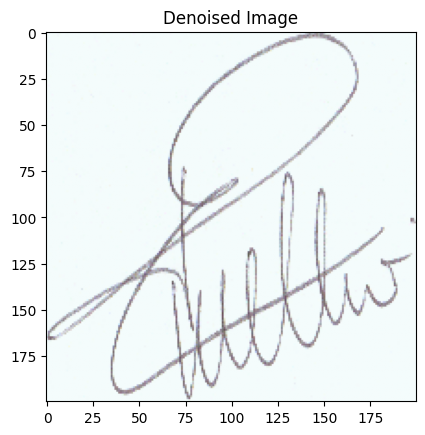

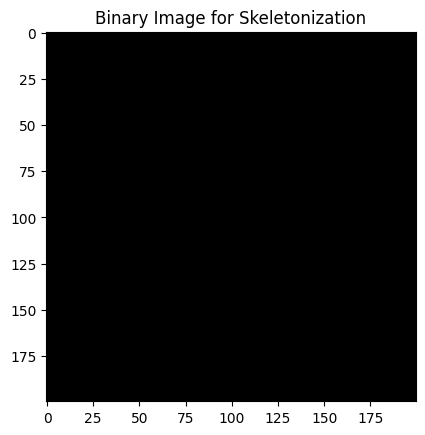

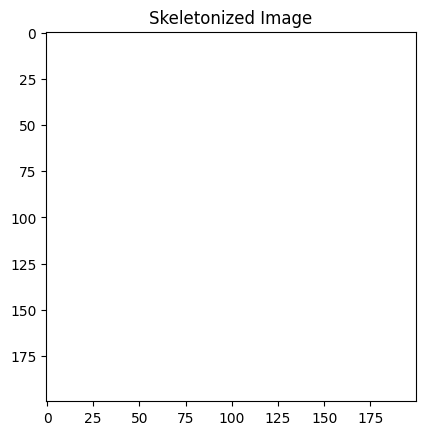

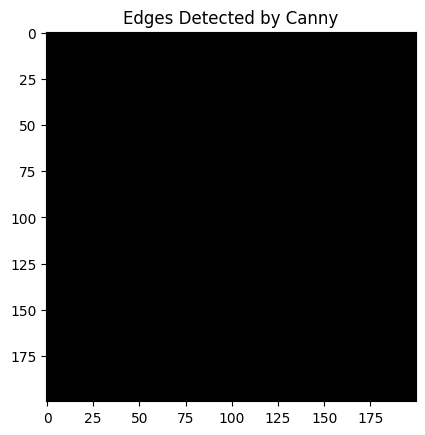

...

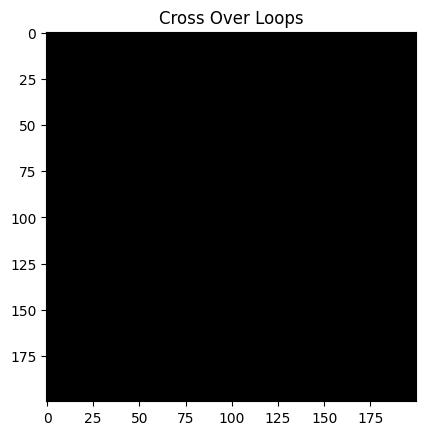

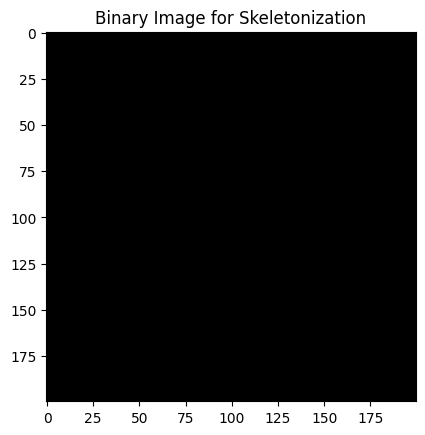

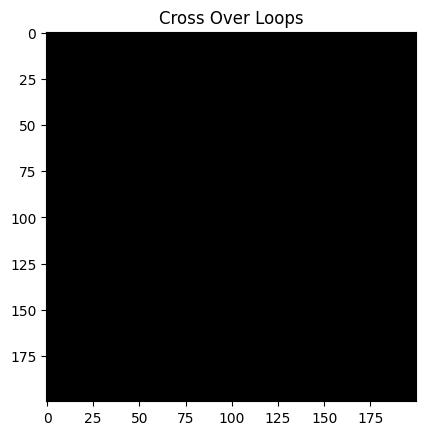

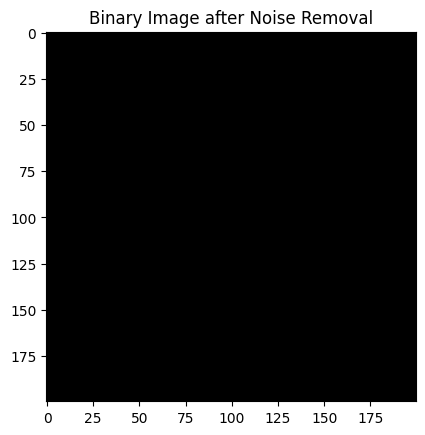

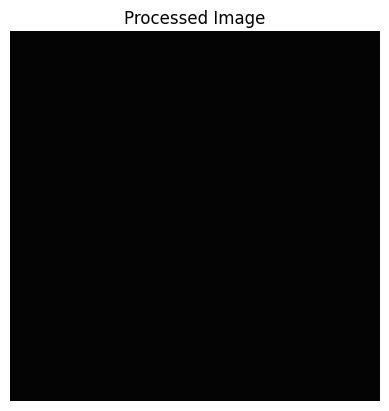

In [ ]:
import matplotlib.pyplot as plt

# Get a batch of images and labels
batch_images, batch_labels = next(train_generator)

# Select an image index
image_index = 5  # Change this to the image index you want to visualize

if image_index < len(batch_images):
    image = batch_images[image_index]

    # Apply noise removal
    processed_image = remove_noise(image)

    # Visualize the processed image
    plt.imshow(processed_image, cmap='gray')
    plt.title("Processed Image")
    plt.axis('off')
    plt.show()
else:
    print("Index out of bounds.")


###Creating a CNN Model

In [ ]:
class MyModel(tf.keras.Model):

  def __init__(self):
    super(MyModel, self).__init__()

    self.cnn1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', input_shape=(3,200,200))
    self.cnn2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu')
    self.cnn3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu')

    self.flatten = tf.keras.layers.Flatten()

    self.dense1 = tf.keras.layers.Dense(128, activation='relu')
    self.dense2 = tf.keras.layers.Dense(1, activation='sigmoid')

  def call(self, inputs):

    x = self.cnn1(inputs)
    x = self.cnn2(x)
    x = self.cnn3(x)

    x = self.flatten(x)
    x = self.dense1(x)
    x = self.dense2(x)

    return x

model = MyModel()

Initiliazing Input Size

In [ ]:
input_shape = (None, 200, 200, 3)
model.build(input_shape)
model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/layer.py:372: UserWarning: `build()` was called on layer 'my_model_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


Model: "my_model_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)                    │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

Compiling Model

In [ ]:
model.compile(
    loss="binary_crossentropy",
    optimizer=tf.keras.optimizers.RMSprop(learning_rate=2e-5),
    metrics=["acc"]
)

Tranning The Model

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=40,
    verbose=2
)

error: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/thresh.cpp:1559: error: (-2:Unspecified error) in function 'double cv::threshold(cv::InputArray, cv::OutputArray, double, double, int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 16 (CV_8UC3)


To Save and Load The Model

In [ ]:
#Save the model
model.save('my_model', save_format='tf')

# Load the model
loaded_model = tf.keras.models.load_model('/content/my_model')

# Optionally compile the loaded model if you plan to continue training
loaded_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
acc = history.history["acc"]
loss = history.history["loss"]
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, "bo", )
plt.legend()
plt.figure()
plt.plot(epochs, loss, "bo")
plt.legend()
plt.show()

In [ ]:
model.evaluate(test_generator)

##Testing The Model

In [ ]:
plt.imshow(test_generator[0][0][5])
print("Label : ",test_generator[0][1][5])

test_input = test_generator[0][0][5]
test_input = np.expand_dims(test_input,axis=0)
test_input = np.expand_dims(test_input,axis=0)
test_input = np.expand_dims(test_input,axis=0)

pred = model.predict(test_input)

if pred<=0.8:
    pred = 1

else:

    pred = 0

print("Predict : ",pred)

In [ ]:
plt.imshow(test_generator[5][0][20])
print("Label : ",test_generator[5][1][20])

test_input = test_generator[0][0][30]
test_input = np.expand_dims(test_input,axis=0)
test_input = np.expand_dims(test_input,axis=0)
test_input = np.expand_dims(test_input,axis=0)

pred = model.predict(test_input)

if pred<=0.8:
    pred = 1

else:

    pred = 0

print("Predict : ",float(pred))

# 2. Visualization Of The Preprocessing and Feature Extraction

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.morphology import skeletonize
from skimage.color import rgb2gray
from keras.preprocessing.image import ImageDataGenerator
import cv2

In [ ]:
# Function to visualize images
def visualize_before_after(original, original_name, processed, process_name):
    plt.figure(figsize=(10, 5))

    # Original image
    plt.subplot(1, 2, 1)
    plt.title(original_name)
    plt.imshow(original, cmap='gray')
    plt.axis('off')

    # Processed image
    plt.subplot(1, 2, 2)
    plt.title(process_name)
    plt.imshow(processed, cmap='gray')
    plt.axis('off')

    plt.show()

### 1. Denoise

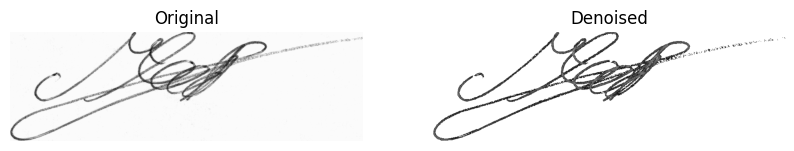

In [ ]:
def remove_noise(image):
    # Threshold value using Otsu's method
    T = cv2.threshold((image * 255).astype(np.uint8), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

    # Logical index of pixels to keep (exclude spark component)
    logInd = image * 255 > T

    # Initialize R, G, B channels with bluish values
    R = np.full(image.shape, 5, dtype=np.uint8)
    G = np.full(image.shape, 3, dtype=np.uint8)
    B = np.full(image.shape, 20, dtype=np.uint8)

    # Get original pixels without sparks
    R[logInd] = (image * 255)[logInd]
    G[logInd] = (image * 255)[logInd]
    B[logInd] = (image * 255)[logInd]

    # Concatenate Red, Green, Blue channels
    rgbImage = np.stack((R, G, B), axis=-1)

    # Convert back to grayscale for visualization
    denoised_image = rgb2gray(rgbImage)

    return denoised_image

# Load an example image using OpenCV
image_path = '/content/Test/Real/064/09_064.png'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
image_rescaled = image / 255.0  # Rescale to [0, 1] range

# Apply the denoise preprocessing function
denoised_image = remove_noise(image_rescaled)

#Invert the black and white of image
denoised_image = 1 - denoised_image

# Visualize the original and thinned images
visualize_before_after(image_rescaled, 'Original', denoised_image, 'Denoised')

### 2. Thinning

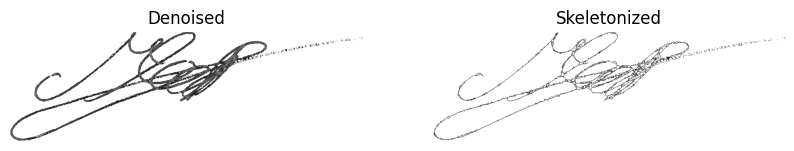

In [ ]:
import cv2
import numpy as np
from skimage.morphology import skeletonize
#Import the cv2_imshow function from google.colab.patches
from google.colab.patches import cv2_imshow

def preprocess_and_skeletonize(image):
    # Check if the image is loaded correctly
    if image is None:
        print("Failed to load image.")
        return None
    # Convert the image to 8-bit grayscale
    image_8bit = (image * 255).astype(np.uint8)  # Convert to 8-bit
    # Apply adaptive thresholding
    binary_image = cv2.adaptiveThreshold(image_8bit, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                          cv2.THRESH_BINARY_INV, 11, 2)
    # Skeletonize the binary image
    skeletonized_image = skeletonize(binary_image / 255).astype(np.uint8) * 255
    # Invert the black and white of the skeletonized image
    skeletonized_image = 255 - skeletonized_image

    return skeletonized_image

# Example usage:
# Assuming you have denoised_image available

# Preprocess and skeletonize the image
skeletonized_image = preprocess_and_skeletonize(denoised_image)

visualize_before_after(denoised_image, 'Denoised', skeletonized_image, 'Skeletonized')

###3. High Intensity Variation Regions

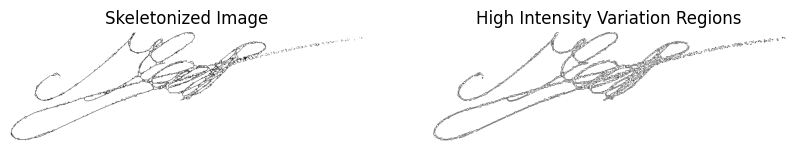

In [ ]:
def hivr(skeletonized_image):
  # Check if the image is loaded correctly
  if skeletonized_image is None:
      print("Failed to load skeletonized image.")
  else:
      # Step 1: Detect edges using Canny edge detection on the skeletonized image
      edges = cv2.Canny(skeletonized_image, 50, 150)

      # Step 2: Extract features from the edges (high variation regions)
      features = []

      # Iterate over each high variation region
      contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
      for contour in contours:
          # Extract features from each region (example: perimeter)
          perimeter = cv2.arcLength(contour, True)
          features.append(perimeter)
  return edges

hivr = hivr(skeletonized_image)
hivr = 255 - hivr
visualize_before_after(skeletonized_image, 'Skeletonized Image', hivr, 'High Intensity Variation Regions')


###4. Cross Over Loop

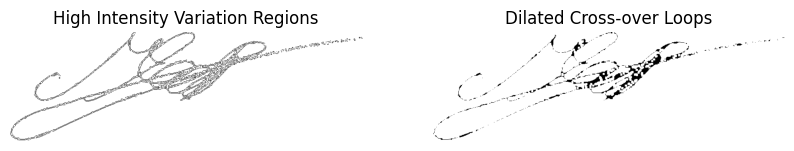

In [ ]:
# Function to detect cross-over loops
def detect_cross_over_loops(edges):
    # Apply morphological dilation to thicken lines
    dilated_image = cv2.dilate(edges, np.ones((3, 3), dtype=np.uint8), iterations=1)

    # Apply morphological erosion to thin the lines slightly
    eroded_image = cv2.erode(edges, np.ones((3, 3), dtype=np.uint8), iterations=1)

    # Perform bitwise AND operation between the dilated and eroded images to find intersections
    cross_over_loops = cv2.bitwise_and(dilated_image, eroded_image)

    dilated_cross_over_loops = cv2.dilate(cross_over_loops, np.ones((5, 5), dtype=np.uint8), iterations=1)

    return dilated_cross_over_loops

cross_over_loops = detect_cross_over_loops(hivr)
visualize_before_after(hivr, 'High Intensity Variation Regions', cross_over_loops, 'Cross-over Loops')